# MODIS Monthly Snow Preprocessing Pipeline & ARD Analytics Using Dask

The following Workflow uses GEOAnalytics Canada's JupyterHub, Container Registry, Pipeline, and Dask Cluster systems to collect, preprocess, and then analyse data to produce informative ARD Snow Cover products that can then be used by scientists to assess snow accumulation, potential runoff threats, potential avalanche threats, etc.

<!-- ![Snow-Cover-Time-Series-Ends-Plots.png](../images/Snow-Cover-Time-Series-Ends-Plots.png) -->
<img alt="Snow-Cover-Time-Series-Ends-Plots" src="../images/Snow-Cover-Time-Series-Ends-Plots.png">

> **Summary**
> - AOI: Quebec - 1,542,056.14 km2  
> - Product: MODIS Daily Snow Cover - MOD10A1-061  
> - Daily Data Total: 163.99 GB  
> - Total mosaicked files: 1486  
> - Time taken to download one month of daily data using Pipelines: 15-25 minutes  
> - Time taken to process from Daily to Seasonal composites (incl masking) using Dask: 4 minutes and 15 seconds  
> - Processed over 78 thousand distributed tasks to complete process on Dask Cluster before faulty data removal  
> - Processed over 68 thousand distributed tasks to complete process on Dask Cluster before faulty data removal (4 minutes and 3 seconds)  

Monthly median composites are first created using [MODIS Snow Cover Daily (modis-10A1-061) product, a Level-3 product produced by NASA](https://nsidc.org/sites/default/files/mod10a1-v061-userguide_1.pdf) over Quebec, Canada for the winter seasons starting 2014/2015 until 2020/2021. 
The total amount of data being ingested and processed to these monthly composite totals 163.99 Gi over 1486 time and spatial granules - post gather and merging/mosacking of MODIS granules for singular days.

Collecting daily data for an entire province over seven winter seasons involves a large amount of data to process, even though MODIS is a lower spatial resolution sensor (500m/pixel).
This would be challenging to do on a single computer, which traditionally is how this kind of process has been handled in the industry
For a higher overview of the yearly difference, these monthly composites are then composed into a median array representing a single winter season each. 

From the User Guide:
> Snow-covered land typically has very high reflectance in visible bands and very low reflectance in
> shortwave infrared bands. The Normalized Difference Snow Index (NDSI) reveals the magnitude of
> this difference. The snow cover algorithm calculates NDSI for all land and inland water pixels in
> daylight using Terra MODIS band 4 (visible green) and band 6 (shortwave near-infrared).
> NDSI = (B04 - B06) / (B04 + B06)

The L3 MODIS product uses [NDSI to calculate the pixel-wise detection of snow](https://nsidc.org/data/user-resources/help-center/what-ndsi-snow-cover-and-how-does-it-compare-fsc) and when placed in a time-series, can determine the existence frequency of snow suggesting possible accumulation - which could subsequently be cross-analysed with precipitation products to calculate estimated snow quantity. 

Gathering and preprocessing data can easily be automated using GEOAnalytics' Pipeline system. 
By horizontally scaling our data gathering and preprocessing tasks, we can greatly reduce the time it takes to get informative and usable data. 
Horizontally scaling workers allows the distribution of data, meaning less data is processed through a single machine, and so, as well as placing the compute next to the data to reduce network latency and ingress/egress costs, can significantly reduce resourcing costs as less powerful compute resources are required.

We will use Quebec's boundary defined by [Canada's Open Data Provincial Administrative Boudnaries](https://open.canada.ca/data/en/dataset/306e5004-534b-4110-9feb-58e3a5c3fd97/resource/15ea678b-8667-43ce-b80c-6545e039ee00) to focus on  this Province's snow cover.
Using the geometry to determine data intersections, we preprocess to an ARD output, preserving valid data values, and saving out to Cloud Storage to be used in subsequent analytics. 
As an example of how ARD data can be used, this documentation finishes off by collecting another shapefile from Canada's Open Data Portal - the [National Hydrometric Network Index](https://open.canada.ca/data/en/dataset/a4b190fe-e090-4e6d-881e-b87956c07977/resource/982a89a4-10d4-44b4-b0f5-687394472e93) - and showing how it's possible to create more refined data over water basins that compose the Lower Arnaud basin. 

![Lower Arnaud.png](../images/Lower-Arnaud.png)

Each Task in the Pipeline system uses a custom Docker Image, built in the following section, and then pushed to the [GEOAnalytics Container Registry](https://docs.geoanalytics.ca/1_getting_started/08-container-registry.html) (CR).

GEOAnalytics Canada Pipelines leverages Argo Workflows as the underlying workflow manager and we recommend using the Python framework [Hera](https://hera-workflows.readthedocs.io/en/latest/) to declare the components, as shown below.

Reference Links: 
- [Container Registry](https://docs.geoanalytics.ca/1_getting_started/08-container-registry.html)
- [JupyterHub](https://docs.geoanalytics.ca/1_getting_started/03-jupyter-notebooks.html)
- [Pipelines](https://docs.geoanalytics.ca/1_getting_started/09-pipelines.html)
- [Dask](https://docs.geoanalytics.ca/1_getting_started/10-dask.html)

## Imports and Function Declaration

In the following code, the Python packages used throughout the notebook-level processing are imported. 
The Pipeline components include their package imports to be run within the Pipeline system on the custom Docker Image. 

In [2]:
# Section Imports
# ===============
# Global
# ---------------
import os
import io
import getpass

# Pipeline
# ---------------
import yaml
import zipfile
import requests

os.environ['USE_PYGEOS'] = '0'
import geopandas as gpd

from glob import glob
from shapely.geometry import Polygon, MultiPolygon
from typing import List, Dict, Tuple, Any

from hera.shared import global_config
from hera.workflows import (
                        Artifact, 
                        Workflow, 
                        script, 
                        DAG, 
                        Resources, 
                        Parameter, 
                        Env,
                        RetryStrategy,
                        WorkflowTemplate,
                        models as m,
)

# Workflow Submission
# ---------------
from hera.workflows.models import WorkflowTemplateRef

# ARD
# ---------------
import sys
import dask
import json
import xarray
import pystac
import datetime
import requests
import rioxarray

import numpy as np
import matplotlib.pyplot as plt

from PIL import Image
from typing import Dict
from pathlib import Path
from pystac_client import Client
from dask_gateway import Gateway
from IPython.display import HTML
from shapely.ops import unary_union
from collections import defaultdict
from azure.storage.blob import ContainerClient
from dask.distributed import performance_report
from distributed.diagnostics import MemorySampler
from shapely.geometry import Polygon, mapping, shape
from pystac.extensions.projection import ProjectionExtension
# ===============

In [3]:
# Global Configuration
# --------------------

# Global Pipeline Config
# - Workflow declaration and WorkflowTemplate creation/submission
global_config.api_version = "argoproj.io/v1"
global_config.host = os.getenv("WORKFLOW_HOST")

registry_url = 'registry.eo4ph.geoanalytics.ca'
repository = 'tutorial'
image_version_tag = '0.1.1'
docker_image_tag = f'{registry_url}/{repository}/snow-cover:{image_version_tag}'

In [4]:
def generate_polygon(
        target_province: str
    ) -> MultiPolygon:
    """
    Generate a Shapely MultiPolygon based on the input path of 
    collected Shapefile and pulling the target Province's geometry

    inputs:
        target_province: str
            Province geometry to be pulled from collected Shapefile

    outputs:
        MultiPolygon:
            Province geometry concatenated into a single Shapely shape
    """
    try:
        os.makedirs('/tmp/canvec')
    except FileExistsError:
        pass
        
    container_client = ContainerClient(
        os.getenv('AZURE_STORAGE_CONTAINER_URL'),
        container_name=os.getenv('AZURE_STORAGE_CONTAINER_NAME'),
        credential=os.getenv('AZURE_STORAGE_CONTAINER_TOK'),
    )
    blobs = container_client.list_blobs(name_starts_with='AOIs/canvec_15M')
    for blob in blobs:
        out_pth = (Path('/tmp/canvec') / Path(blob.name).name).as_posix()
        # with io.BytesIO() as buf:
        with open(out_pth, 'wb') as f:
            blob_client = container_client.get_blob_client(blob.name)
            f.write(blob_client.download_blob().readall())        
    
    shp_file = glob('/tmp/canvec/*geo_pol*_2.shp')[0]
    gdf = gpd.read_file(shp_file)

    # Pull out Adminitrative Boundary to usable Shape
    tgt_col = 'juri_en'
    aoi_all = gdf[gdf[tgt_col] == target_province]
    mp = MultiPolygon([poly for poly in aoi_all.geometry.values.tolist() if isinstance(poly, Polygon)])
    return mp

## Create Custom Container Image From Dockerfile

To be able to execute the functions we will be implementing in the Pipeline, we will need to create a custom minimal environment for them to run.
In this documentation, we use Python's Docker framework to build our Image, log in to [GEOAnalytics Container Registry](https://docs.geoanalytics.ca/1_getting_started/08-container-registry.html) (CR), and finally push our Image to be used in our Pipeline Workflow. 

The Pipeline system is capable of pulling Images from the GEOAnalytics CR.
This allows Users to adapt different environments for different tasks, rather than needing to create a monolithic environment for all operations to run in. 
The same effect can be accomplished via an external Dockerfile and using the Docker CLI commands rather than using the string-approach in this section.

In [ ]:
! pip install --user docker==6.1.3

In [ ]:
# Imports
import docker

In [ ]:
# DinD (Docker in Docker) sidecar is accessible over localhost
docker_client = docker.from_env()

The following code shows a String representation of a Dockerfile which can be turned into a Pythonic file-like object, which the Python Docker framework `build()` method accepts. 
Alternatively, if keeping such things in memory is not necessary, a file path on the filesystem can be used to point at a Dockerfile. 

In [ ]:
dockerfile = """
FROM python:3.11-slim
RUN apt update --no-install-recommends \
    >>/dev/null
    
RUN pip install \
        pandas==2.0.3 \
        geopandas==0.13.2 \
        numpy==1.24.4 \
        pystac==1.8.3 \
        pystac_client==0.7.2 \
        planetary-computer==1.0.0 \
        odc-stac==0.3.6 \
        azure-storage-blob==12.17.0 \
        xarray==2023.7.0 \
        rioxarray==0.15.0 \
        pyproj==3.6.0 \
        shapely==2.0.1 \
        Pillow==10.0.0
"""
dockerfile_file = io.BytesIO(dockerfile.encode())
dockerfile_file.name = 'dockerfile'
docker_client.images.build(fileobj=dockerfile_file, tag=docker_image_tag)

Log in to GEOAnalytics CR using your username and password. 
You will need to log in in order to 
1. verify that you are a authenticated User and
2. be able to push to your public and private repositories. 

In [ ]:
docker_client.login(
    username=os.getenv('JUPYTERHUB_USER'),
    password=getpass.getpass(),
    registry=registry_url
)

Finally, push your new custom Image to the CR. 

In [ ]:
docker_client.images.push(docker_image_tag)

## Pipeline Workflow

This section declares the components used in the preprocessing workflow. 
1. Input Validation - ensures user-input arguments are within bounds
2. Query Date - demonstration of collecting data dates that exist from Planetary Computer
3. Process Image Tiles - collect the data from previous step's date item handed to a worker and preprocess to AOI isolated ARD image

You can see from the `@script` wrappers from `hera` that we adapt the compute resources between different components as the validation and query steps are computationally minimally demanding as compared to the processing task. 
Further optimisations can reduce workflow cost by provisioning/sharing compute resources that the workflow fits in. 

Set the Global configuration for Argo Workflows - the underlying system for GEOAnalytics Canada Pipelines. 
GEOAnalytics Canada offers a variety of Node types to provision workloads on to. To determine what is available, contact the Admin group. 

In [27]:
user_config = None
with open(f'/home/jovyan/geoanalytics_{os.getenv("JUPYTERHUB_USER")}/userConfig.yaml', 'r') as f:
    user_config = yaml.safe_load(f)

In [28]:
pipeline_node_config = user_config['pipeline']['node-config']

Using the configuration set by the User at the main workflow's entrypoint, we generate a "payload" for subsequent Tasks which will allow the desired set of data to be gathered and processed. 

This Task can also be configured in a [CRON Workflow](https://argoproj.github.io/argo-workflows/cron-workflows/) (a Workflow that executes on a specific schedule) ([Hera implementation](https://hera-workflows.readthedocs.io/en/latest/examples/workflows/upstream/cron_workflow/?h=cron)) where the `year` and `month` arguments may be `None` and therefore default to the current year and month, as defined by the functions code.
For example, a CRON schedule for the beginning of a month (given a few days for L3 data to be processed and uploaded) can be set to ingest data of interest automatically for the previous month. 

In [ ]:
@script(
    image=docker_image_tag,
    resources=Resources(cpu_request='100m', memory_request='128Mi'),
    node_selector=pipeline_node_config['small']['nodeSelector'],
    tolerations=pipeline_node_config['small']['tolerations'],
)
def input_validation(
        catalog_url: str,
        collection: str,
        assets: List[str],
        year: int | None,
        month: int | None,
        target_province: str,
        output_prefix: str = '',
    ):
    """
    Validates the input parameters for a MODIS data query, such as year, month and other query parameters.  

    Parameters:  
    catalog_url (str): The catalog URL to be used for querying MODIS data.  
    collection (str): The collection name for the MODIS data to be queried.  
    assets (List[str]): The list of assets to be queried.  
    year (int | None): The year for which the MODIS data is to be queried. Defaults to the current year.  
    month (int | None): The month for which the MODIS data is to be queried. Defaults to the current month.  
    target_province (str): The target province for the data query.  
    output_prefix (str, optional): A prefix to be added to the output file names. Defaults to an empty string.

    Returns:  
    None: The function does not return any value but raises ValueError if any of the input parameters are invalid. 
    
    > **Note** Argo will capture the stdout contents as output
    """
    import sys
    import json
    from datetime import datetime

    if year is None:
        int(datetime.now().strftime('%Y'))
    elif int(year) < 2000:
        raise ValueError(f'MODIS collection starts at 02/24/2000: Error {start_year}')
    elif int(year) > int(datetime.now().strftime('%Y')) and month > int(datetime.now().strftime('%m')):
        raise ValueError(f'Cannot query future: Error {end_year}')
    else:
        pass
    
    if month is None:
        month = int(datetime.now().strftime('%m'))
    elif int(month) < 1 or int(month) > 12:
        raise ValueError(f'Month range is from 1 to 12, inclusive: Error: {start_month}')
    else:
        pass

    if month < 10:
        month = f'0{month}'

    payload = {
        'catalog_url': catalog_url,
        'collection': collection,
        'assets': assets,
        'year': year,
        'month': month,
        'output_prefix': output_prefix
    }
    json.dump(payload, sys.stdout)  
    

Using the temporal range list and the AOI Artifact, we can parallelise querying for available data from [Planetary Computer's STAC server](https://planetarycomputer.microsoft.com/dataset/modis-10A1-061#overview).
MODIS Snow Cover Daily, as the name states, is a daily product. 
However, as can be seen in the following Task, the dates gathered by the initial query are converted into a new "payload" for the next Task. 
This implements some resiliency to missing dates or when targeting a non-daily product in order to successfully gather data.

In [30]:
@script(
    image=docker_image_tag,
    resources=Resources(cpu_request='500m', memory_request="3Gi"),
    node_selector=pipeline_node_config['small']['nodeSelector'],
    tolerations=pipeline_node_config['small']['tolerations'],
    inputs=[
        Parameter(name='aoi'),
        Parameter(name='payload')
    ],
)
def query_for_data(aoi: str, payload: Dict[str, Any]):
    """
    Queries MODIS data for a given area of interest (AOI) and payload parameters.  
      
    Parameters:  
    aoi (str): A WKT string representing the area of interest for the data query.  
    payload (Dict[str, Any]): A dictionary containing the query parameters such as catalog_url, collection, assets, year, month, and output_prefix.  
      
    Returns:  
    None: The function does not return any value but prints the JSON payload for the queried MODIS data items. 

    > **Note** Argo will capture the stdout contents as output
    """
    import os
    import sys
    import json
    import shapely.wkt
    import pystac_client
    import planetary_computer

    os.environ['USE_PYGEOS'] = '0'
    import geopandas as gpd
    
    from pathlib import Path
    from datetime import datetime

    if isinstance(payload, str):
        payload = json.loads(payload)
        
    geom = shapely.wkt.loads(aoi)

    catalog = pystac_client.Client.open(
        payload['catalog_url']
    )

    query_time_range = f"{payload['year']}-{payload['month']}"
    query = catalog.search(
        collections=payload['collection'],
        intersects=geom.envelope,
        datetime=query_time_range
    )

    item_payloads = []
    day_track_list = []
    for item in query.items_as_dicts():
        target_date = datetime.strftime(
            datetime.strptime(
                item['properties']['start_datetime'], 
                '%Y-%m-%dT%H:%M:%SZ'
            ), '%Y-%m-%d')
        if target_date not in day_track_list:
            day_track_list.append(target_date)
            item_payload = {}
            item_payload.update(payload)
            item_payload['query-date'] = target_date
            item_payloads.append(item_payload)
    
    json.dump(item_payloads, sys.stdout)



The following Task is the engine of the preprocessing - the data is pulled and operated on. 
As networks can be susceptible to down-time, a `RetryStrategy` is implemented in order to attempt again in case of a failed communication. 
If the request fails up to the limit, then this and subsequent Tasks will also fail. 
The AOI Artifact retrieved at the beginning of the Workflow is now used not just to query but also to clip the retrieved data. 
This minimises unwanted data being stored and further processed - avoiding wasting compute on what would be discarded otherwise. 
Each Task will receive a list of payloads targetting the temporal window defined in the previous step (a month in this specific case). 
Once preprocessed, the data is saved to Cloud storage and the path to that data is delivered to the next Task. 

In [31]:
@script(
    image=docker_image_tag,
    resources=Resources(cpu_request='2000m', memory_request="16Gi"),
    node_selector=pipeline_node_config['medium']['nodeSelector'],
    tolerations=pipeline_node_config['medium']['tolerations'],
    retry_strategy=RetryStrategy(
            limit=3,
            backoff=m.Backoff(
                duration="5",
                factor="2",
                max_duration="5m",
            )
    ),
    inputs=[
        Parameter(name='aoi'),
        Parameter(name='payload')
    ],
)
def process_image_tiles(aoi: str, payload: str):
    """
    Processes MODIS image tiles for a given area of interest (AOI) and payload parameters.  
      
    Parameters:  
    aoi (str): A WKT string representing the area of interest for the data query.  
    payload (str): A JSON string containing the query parameters such as catalog_url, collection, assets, query-date, year, and month.  
  
    Returns:  
    None: The function does not return any value but uploads the processed image tiles to the specified storage container.  

    > **Note** Argo will capture the stdout contents as output
    """
    import io
    import os
    import gc
    import sys
    import json
    import xarray
    import pyproj
    import odc.stac
    import requests
    import rioxarray
    import shapely.wkt
    import pystac_client
    import planetary_computer
    
    import numpy as np
    os.environ['USE_PYGEOS'] = '0'
    import geopandas as gpd
    import numpy as np
    
    from pathlib import Path
    from shapely.ops import transform
    from rioxarray.merge import merge_arrays
    from azure.storage.blob import ContainerClient

    container_client = ContainerClient(
            os.getenv('AZURE_STORAGE_CONTAINER_URL'),
            container_name=os.getenv('AZURE_STORAGE_CONTAINER_NAME'),
            credential=os.getenv('AZURE_STORAGE_CONTAINER_TOK'),
        )

    geom = shapely.wkt.loads(aoi)

    catalog = pystac_client.Client.open(
        payload['catalog_url'],
        modifier=planetary_computer.sign_inplace
    )

    output_paths = []
    query = catalog.search(
        collections=payload['collection'],
        intersects=geom.envelope,
        datetime=payload['query-date']
    )

    try:
        modis_granules = []
        for item in query.items():
            data_crs = 3978
            data = odc.stac.load(
                [item],
                bands=payload['assets'],
                crs=data_crs
            )
            if isinstance(data, xarray.Dataset):
                asset = payload['assets'][0]
                data = data.to_array(dim=asset, name=asset)
            
            # Remove all dimensions of one
            data = data.squeeze()
    
            # Preprocess to omit unwanted values
            filtered_data = xarray.where(((data == 0)|(data > 100)), np.nan, data, keep_attrs=True)
            filtered_data.rio.write_nodata(np.nan, inplace=True)
            filtered_data.rio.write_crs(data_crs, inplace=True)
            modis_granules.append(filtered_data)
    except requests.exceptions.HTTPError as e:
        print(payload['query-date'])
        sys.exit(1)
        
    # Merge all granules into our AOI
    merged_data = merge_arrays(
        modis_granules,
        nodata=np.nan
    )
    
    # Clip data to reduce size and isolate to AOI
    clipped_data = merged_data.rio.clip(
                            [geom],
                            crs=4326, # input geometry CRS - not data CRS
                            all_touched=True,
                            drop=True
                        )

    # Resetting nodata to 255 in order to reduce array size based on dtype
    # and therefore quicker to communicate over networks as our valid data 
    # range is now 0-255 and can be converted to uint8.
    final_data = xarray.where(np.isnan(clipped_data), 255, clipped_data, keep_attrs=True).astype(np.uint8)
    final_data.rio.write_nodata(255, inplace=True)
    final_data.rio.write_crs(data_crs, inplace=True)
    
    # Write Raster
    filename = f"{payload['query-date']}.tif"
    output_path = (Path(payload['output_prefix']) /  
                   Path(f"{payload['year']}-{payload['month']}") /
                   Path(filename)
                   ).as_posix()
    
    
    blob_client = container_client.get_blob_client(output_path)

    with io.BytesIO() as buf:
        final_data.rio.to_raster(buf, driver='GTiff')
        buf.seek(0)
        blob_client.upload_blob(buf, overwrite=True)
        
    blob_client.close()
    output_paths.append(output_path)
    del query, data, modis_granules, filtered_data, merged_data, clipped_data
    gc.collect()

    container_client.close()
    json.dump(output_paths, sys.stdout)


## Main Workflow Entrypoint

The main entrypoint to the Workflow. 
Here we will use the declared Tasks from above and organise them into our Pipeline workflow. 

The AOI file is hosted as a zipped up Shapefile. From [Canada's Open Data Portal](https://open.canada.ca/en), we can use Python's `requests` library to `GET` the [data](https://open.canada.ca/data/en/dataset/306e5004-534b-4110-9feb-58e3a5c3fd97/resource/15ea678b-8667-43ce-b80c-6545e039ee00). 
However, shapefiles are difficult to use when not on a local filesystem or when needing to distribute vector data - so we will load an already transferred and unzipped version this from local and deliver a MultiPolygon, created from the target geometry, into the workflow as an argument. 

In [32]:
# Convenience list of Canadian Provinces in a left-to-right then up and back order
target_provinces = [
    'British Columbia',               # 0
    'Alberta',                        # 1
    'Saskatchewan',                   # 2
    'Manitoba',                       # 3
    'Ontario',                        # 4
    'Quebec',                         # 5
    'New Brunswick',                  # 6
    'Nova Scotia',                    # 7
    'Prince Edward Island',           # 8
    'Newfoundland and Labrador',      # 9
    'Nunavut',                        # 10
    'Northwest Territories',          # 11
    'Yukon'                           # 12
]

In [33]:
# Workflow Configuration Section
# ==============================

# The Province name is used as an identifier into Storage
# as well as retrieving the correct geometry from our shapefile
aoi_list_idx = 5
target_province = target_provinces[aoi_list_idx]
prov_pth_piece = target_province.replace(' ', '').strip().lower()

# Planetary Computer STAC Configuration
catalog_url = 'https://planetarycomputer.microsoft.com/api/stac/v1'
collection = 'modis-10A1-061'
assets = ['NDSI_Snow_Cover']
container_folder_prefix = f'modis/{target_province}/daily-snow'

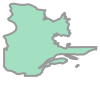

In [34]:
aoi = generate_polygon(target_province)
aoi

Here we define our Workflow structure that will be submitted to the Pipeline.
We create an entry point of the Workflow as `data-pipe`, which is declared toward the bottom. 
The data validation and gathering tasks are placed in sequence where the following processing task will be distributed horizontally from the stdout List that is captured. 
In order to perform non-blocking horizontal scaling, the processing task is placed in its own Directed Acyclic Graph (DAG) - a flow structure that defines a beginning and end without introducing cyclic behavior causing the Workflow to become stuck in a loop. 
This also allows the processing task to operate independently from the other processing tasks; if subsequent tasks are appended to its DAG, they would run as its prior task completes regardless of where the other processing tasks are in their respective DAGs. This provides concurrent progress through the data without bottlenecks or blocking of operations.

In [35]:
with Workflow(
    name=f"ingest-{collection.lower()}",
    namespace=os.getenv("WORKFLOW_NS"),
    entrypoint="data-pipe",
    parallelism=10,
    pod_gc={'strategy': 'OnPodSuccess'},
    arguments=[
            Parameter(name='catalog_url'),
            Parameter(name='collection'),
            Parameter(name='assets'),                               
            Parameter(name='year'),
            Parameter(name='month'),
            Parameter(name='target_province'),
            Parameter(name='output_prefix'),
            Parameter(name='aoi'),   
    ]
) as wf:

    with DAG(
        name='ingest',
        inputs=[
            Parameter(name='aoi'),
            Parameter(name='payload')
        ]
    ) as ingest_dag:
        a2 = process_image_tiles(
            arguments={
                'aoi': '{{workflow.parameters.aoi}}',
                'payload': '{{inputs.parameters.payload}}'
            },
        )

        a2
        # Include additional preprocessing Tasks 
        # by joining them into the DAG: a2 >> ...
    
    with DAG(
        name='data-pipe', 
    ) as _d:
        a0 = input_validation(
                inputs=[
                    wf.get_parameter('aoi').with_name('aoi')
                ],
                arguments={
                        'catalog_url': '{{workflow.parameters.catalog_url}}',
                        'collection': '{{workflow.parameters.collection}}',
                        'assets': '{{workflow.parameters.assets}}',                               
                        'year': '{{workflow.parameters.year}}',
                        'month': '{{workflow.parameters.month}}',
                        'target_province': '{{workflow.parameters.target_province}}',
                        'output_prefix': '{{workflow.parameters.output_prefix}}'
                    }
            )

        a1 = query_for_data(
            arguments=[
                Parameter(name='aoi', value='{{workflow.parameters.aoi}}'),
                Parameter(name='payload', value=a0.result)
            ]
        )
        proc = ingest_dag(
            name='ingest-data',
            arguments={
                'aoi': '{{workflow.parameters.aoi}}',
                'payload': '{{item}}'
            },
            with_param = a1.result
        )
        a0 >> a1 >> proc
        

The following two lines of Python create a Workflow Template of our declared Workflow above. 
This template is then pushed to our Pipelines server, allowing Users to reference it without needing the full declaration and to also offer the possibility of non-programmers to submit the Workflow from the Pipeline UI. 

In [36]:
wft = WorkflowTemplate().from_dict(wf.to_dict())
wft.update();

To retrieve the desired data over our AOI and time range of interest, we can split the temporal input parameters into logical pieces that the workflow understands. Doing this avoids collecting and processing data that will not be subsequently used. 

In [37]:
wft = WorkflowTemplateRef(
        name="ingest-modis-10a1-061",
        template="ingest-modis-10a1-061",
    )

In [38]:
def submit_workflow(
    wf_name: str, 
    year: int, 
    month: int,
    catalog_url: str,
    collection: str,
    assets: List[str],
    target_province: str,
    container_folder_prefix: str,
    aoi: Polygon | MultiPolygon,
    parallelism: int = 10
):
    """
    Submits a Workflow to process and analyze geospatial data for a specified area of interest (AOI).

    Parameters:  
    wf_name (str): The name of the Workflow to be created.  
    year (int): The year of the data to be processed.  
    month (int): The month of the data to be processed.  
    catalog_url (str): The URL of the STAC catalog containing the data.  
    collection (str): The collection within the STAC catalog to be queried.  
    assets (List[str]): A list of asset names to be processed.  
    target_province (str): The target province for the analysis.  
    container_folder_prefix (str): The prefix for the storage container folder where the output data will be stored.  
    aoi (Polygon | MultiPolygon): A shapely geometry (Polygon or MultiPolygon) representing the area of interest.  
    parallelism (int, optional): The number of parallel tasks to be executed in the Workflow. Defaults to 10.

    Returns:  
    None: The function does not return any value but creates and submits a Workflow.     
    """
    w = Workflow(
        name=wf_name,
        workflow_template_ref=wft,
        namespace=os.getenv("WORKFLOW_NS"),
        entrypoint="data-pipe",
        parallelism=parallelism,
        arguments=[
            Parameter(name='catalog_url', value=catalog_url),
            Parameter(name='collection', value=collection),
            Parameter(name='assets', value=assets),
            Parameter(name='year', value=year),
            Parameter(name='month', value=month),
            Parameter(name='target_province', value=target_province),
            Parameter(name='output_prefix', value=container_folder_prefix),
            Parameter(name='aoi', value=aoi.wkt)
        ]
    )
    
    w.create(); # semi-colon mutes Jupyter Notebook output

We use the above function repeatedly to submit workflows for our target time-range. 
As we begin our example in the 2014/2015 winter season, we must collect the end of 2014 from October to December.
From there, we submit Workflows to gather the data for each subsequent year. 
Finally, we collect the end of our time-range of 2021 January to April. 

In [180]:
# Front range
year = 2014
months = [10, 11, 12]

for month in months:
    submit_workflow(
        wf_name=f"ingest-{collection.lower()}-{prov_pth_piece}-{year}-{month}",
        year=year,
        month=month,
        catalog_url=catalog_url,
        collection=collection,
        assets=assets,
        target_province=target_province,
        container_folder_prefix=container_folder_prefix,
        aoi=aoi
    )

In [195]:
year = 2015
months = [10, 11, 12, 1, 2, 3, 4]
for month in months:
    submit_workflow(
        wf_name=f"ingest-{collection.lower()}-{prov_pth_piece}-{year}-{month}",
        year=year,
        month=month,
        catalog_url=catalog_url,
        collection=collection,
        assets=assets,
        target_province=target_province,
        container_folder_prefix=container_folder_prefix,
        aoi=aoi,
        parallelism=5
    )

In [196]:
year = 2016
months = [10, 11, 12, 1, 2, 3, 4]
for month in months:
    submit_workflow(
        wf_name=f"ingest-{collection.lower()}-{prov_pth_piece}-{year}-{month}",
        year=year,
        month=month,
        catalog_url=catalog_url,
        collection=collection,
        assets=assets,
        target_province=target_province,
        container_folder_prefix=container_folder_prefix,
        aoi=aoi,
        parallelism=5
    )

In [197]:
year = 2017
months = [10, 11, 12, 1, 2, 3, 4]
for month in months:
    submit_workflow(
        wf_name=f"ingest-{collection.lower()}-{prov_pth_piece}-{year}-{month}",
        year=year,
        month=month,
        catalog_url=catalog_url,
        collection=collection,
        assets=assets,
        target_province=target_province,
        container_folder_prefix=container_folder_prefix,
        aoi=aoi,
        parallelism=5
    )

In [198]:
year = 2018
months = [10, 11, 12, 1, 2, 3, 4]
for month in months:
    submit_workflow(
        wf_name=f"ingest-{collection.lower()}-{prov_pth_piece}-{year}-{month}",
        year=year,
        month=month,
        catalog_url=catalog_url,
        collection=collection,
        assets=assets,
        target_province=target_province,
        container_folder_prefix=container_folder_prefix,
        aoi=aoi,
        parallelism=5
    )

In [199]:
year = 2019
months = [10, 11, 12, 1, 2, 3, 4]
for month in months:
    submit_workflow(
        wf_name=f"ingest-{collection.lower()}-{prov_pth_piece}-{year}-{month}",
        year=year,
        month=month,
        catalog_url=catalog_url,
        collection=collection,
        assets=assets,
        target_province=target_province,
        container_folder_prefix=container_folder_prefix,
        aoi=aoi,
        parallelism=5
    )

In [200]:
year = 2020
months = [10, 11, 12, 1, 2, 3, 4]
for month in months:
    submit_workflow(
        wf_name=f"ingest-{collection.lower()}-{prov_pth_piece}-{year}-{month}",
        year=year,
        month=month,
        catalog_url=catalog_url,
        collection=collection,
        assets=assets,
        target_province=target_province,
        container_folder_prefix=container_folder_prefix,
        aoi=aoi,
        parallelism=5
    )

In [201]:
# End range
year = 2021
months = [1, 2, 3, 4]

for month in months:
    submit_workflow(
        wf_name=f"ingest-{collection.lower()}-{prov_pth_piece}-{year}-{month}",
        year=year,
        month=month,
        catalog_url=catalog_url,
        collection=collection,
        assets=assets,
        target_province=target_province,
        container_folder_prefix=container_folder_prefix,
        aoi=aoi,
        parallelism=5
    )

## ARD Workflow

Analysis(/Analytics) Ready Data (ARD) is used to implement and produce understandable and actionable outcomes for the Users. 
In this example, we will procude monthly median composites for each winter season. 
These monthly composites alone can provide a wealth of information and further analysis by indicating the likelihood of snow cover throughout the season leading to high-risk areas for run-off flooding, as a single example. 
We go further by creating seasonal median composites to offer intra-seasonal differences.
The higher up the temporal stack we go, the less useful the data becomes as it loses it's granularity, but can still provide a high-level overview of the situation. 
Finally, we take the water-basin geometries as mentioned at the beginning and clip our seasonal medians to the Lower Arnaud water-basin AOI. 
We then plot the seasonal data to be used in reports or for further analysis at the pixel level. 
This high-level seasonal information can then be used to subsequently backtrack to the monthly medians and determine causes for any area's of concern between seasons. 
For brevity, we stop at plotting the data. 

In [4]:
@dask.delayed
def write_raster(
    raster_array: xarray.DataArray | xarray.Dataset,
    output_path: str,
    storage_credentials: Dict[str, str]
) -> str:
    """  
    Writes a raster file from a given raster array and uploads it to an Azure storage container as a Cloud Optimized GeoTIFF (COG).

    Parameters:  
    raster_array (xarray.DataArray | xarray.Dataset): The input raster array or dataset to be converted to a GeoTIFF file.  
    output_path (str): The path within the storage container where the GeoTIFF file will be stored.  
    storage_credentials (Dict[str, str]): A dictionary containing the required credentials for accessing the Azure storage container:  
        - 'AZURE_STORAGE_CONTAINER_URL': The URL of the Azure storage container.  
        - 'AZURE_STORAGE_CONTAINER_NAME': The name of the Azure storage container.  
        - 'AZURE_STORAGE_CONTAINER_TOK': The access token or key for the Azure storage container.

    Returns:  
    str: A string indicating the successful upload of the GeoTIFF file to the specified storage container. 
    """
    container_client = ContainerClient(
        storage_credentials['AZURE_STORAGE_CONTAINER_URL'],
        container_name=storage_credentials['AZURE_STORAGE_CONTAINER_NAME'],
        credential=storage_credentials['AZURE_STORAGE_CONTAINER_TOK'],
    )
    blob_client = container_client.get_blob_client(output_path)
    with io.BytesIO() as buf:
        raster_array.rio.to_raster(buf, driver='COG')
        buf.seek(0)
        blob_client.upload_blob(buf, overwrite=True)
    return f'Successfully uploaded: {output_path}'

We provision a Dask cluster outside of this notebook and use the cluster name to connect to it via Dask Gateway.
Along with our compute environment setup, we declare some configuration variables - this re-declares the target province as this portion of the example runs independently of the Pipelines and has assumed the data has been collected and is ready for analysis. 

In [7]:
# Configuration
cluster_name = 'daskhub.976f73279020432690cfc14b18c21ca3'

storage_creds = {
    'AZURE_STORAGE_CONTAINER_URL': os.getenv('AZURE_STORAGE_CONTAINER_URL'),
    'AZURE_STORAGE_CONTAINER_NAME': os.getenv('AZURE_STORAGE_CONTAINER_NAME'),
    'AZURE_STORAGE_CONTAINER_TOK': os.getenv('AZURE_STORAGE_CONTAINER_TOK')
}

target_province = 'Quebec'
input_path = f'modis/{target_province}/daily-snow'

Isolated in own cell so it can be run only once if needing to connect to one or more cluster.
The gateway object can be used to connect to and create other Dask Clusters.
See [our documentation](https://docs.geoanalytics.ca/1_getting_started/10-dask.html) for more information about Dask in GEOAnalytics Canada.

In [6]:
gateway = Gateway()

In [7]:
cluster = gateway.connect(cluster_name)
dask_client = cluster.get_client() # Grab  the Client so we can operate on the Dask Cluster

In [ ]:
cluster

Set up the Container Client to perform remote storage connections for our target data

In [9]:
container_client = ContainerClient(
    storage_creds['AZURE_STORAGE_CONTAINER_URL'],
    container_name=storage_creds['AZURE_STORAGE_CONTAINER_NAME'],
    credential=storage_creds['AZURE_STORAGE_CONTAINER_TOK'],
)

We shall define our AOI again, as we do not need to run the Pipeline section if the data has already been retrieved.

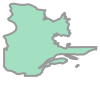

In [8]:
aoi = generate_polygon(target_province)
aoi

Using our configuration variables, we gather the list of available images to process.

In [11]:
blobs = container_client.list_blobs(name_starts_with=input_path)
raster_map = defaultdict(list)
for blob in blobs:
    if '.ipynb_checkpoints' in blob.name:
        container_client.delete_blob(blob)
        continue
    if blob.name.endswith('.png'):
        continue
    pth = Path(blob.name)
    map_key = '-'.join(pth.parts[3].split('-')[:2])
    raster_map[map_key].append(blob.name)
raster_map;

Now we can aggragate those filepaths into logical groups - months - and begin to set up the opening of the files in our Dask Cluster.

In [12]:
raster_month_map = {}
attr_copy = None
for k in raster_map.keys():
    _monthly_data = raster_map[k]
    # Open rasters into the dask cluster
    open_rasters = [
        rioxarray.open_rasterio(
            container_client.get_blob_client(_blob).url, chunks='auto')
        for _blob in _monthly_data]
    raster_month_map[k] = open_rasters
raster_month_map;

Now the files are staged to be opened in the cluster, we declare the next step to create median composites based on each month of data.

In [13]:
monthly_medians = {}
for k in raster_month_map.keys():
    da = xarray.concat(raster_month_map[k], dim='band', combine_attrs='drop_conflicts')
    da_masked = xarray.where(da==255, np.nan, da, keep_attrs=True)
    da_median = da_masked.median(dim='band', skipna=True, keep_attrs=True)
    monthly_medians[k] = da_median
monthly_medians;

In [14]:
monthly_medians.keys()

dict_keys(['2014-10', '2014-11', '2014-12', '2015-01', '2015-02', '2015-03', '2015-04', '2015-10', '2015-11', '2015-12', '2016-01', '2016-02', '2016-03', '2016-04', '2016-10', '2016-11', '2016-12', '2017-01', '2017-02', '2017-03', '2017-04', '2017-10', '2017-11', '2017-12', '2018-01', '2018-02', '2018-03', '2018-04', '2018-10', '2018-11', '2018-12', '2019-01', '2019-02', '2019-03', '2019-04', '2019-10', '2019-11', '2019-12', '2020-01', '2020-02', '2020-03', '2020-04', '2020-10', '2020-11', '2020-12', '2021-01', '2021-02', '2021-03', '2021-04'])

In [15]:
monthly_medians['2015-01']

<xarray.DataArray (y: 3956, x: 3487)>
dask.array<nanmedian, shape=(3956, 3487), dtype=float64, chunksize=(783, 690), chunktype=numpy.ndarray>
Coordinates:
  * x            (x) float64 8.43e+05 8.435e+05 ... 2.458e+06 2.458e+06
  * y            (y) float64 1.643e+06 1.642e+06 ... -1.893e+05 -1.897e+05
    spatial_ref  int64 0

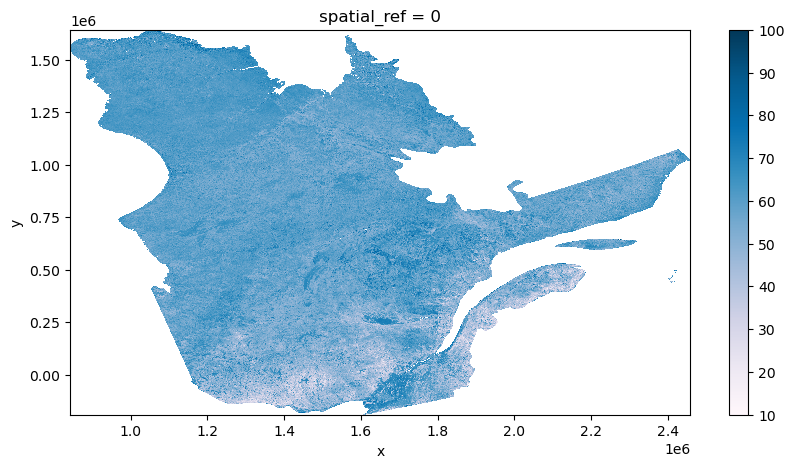

In [16]:
monthly_medians['2015-01'].plot.imshow(figsize=(10,5), cmap='PuBu')

For this demonstration, we create a seasonal median composite, but it is also easily possible to begin inter-year analysis too based on the seasonal groupings. 
A cost-effective approach, if using in subsequent analysis, is to now persist these reference composites that will feed the final analysis data without having to be reprocessed from the beginning each time. 

In [ ]:
seasonal_map = defaultdict(list)
for k in monthly_medians.keys():
    year, month = k.split('-')
    if int(month) < 10:
        seasonal_key = f'{int(year)-1}-{year}'
    else:
        seasonal_key = f'{year}-{int(year)+1}'
    seasonal_map[seasonal_key].append(monthly_medians[k])
seasonal_map;

In [ ]:
seasonal_medians = {}
for k in seasonal_map.keys():
    if k == '2018-2019': # See Appendix (striped data)
        seasonal_map[k].pop(5)
    seasonal_arr = xarray.concat(seasonal_map[k], dim='band')
    seasonal_medians[k] = seasonal_arr.median(dim='band', skipna=True, keep_attrs=True)
seasonal_medians;

Plotting the beginning and end of our time series for visual inspection.

Text(0.5, 1.0, '2020-2021')

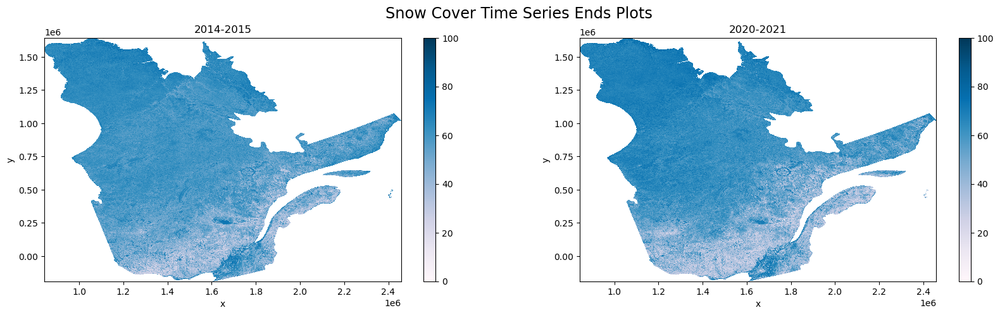

In [80]:
fig, ax = plt.subplots(1,2,figsize=(20,5))
fig.suptitle('Snow Cover Time Series Ends Plots', fontsize='xx-large')
seasonal_medians['2014-2015'].plot.imshow(ax=ax[0], vmin=0, vmax=100, clim=[0,100], cmap='PuBu')
seasonal_medians['2020-2021'].plot.imshow(ax=ax[1], vmin=0, vmax=100, clim=[0,100], cmap='PuBu')
ax[0].set_title('2014-2015')
ax[1].set_title('2020-2021')

In [ ]:
fig.savefig('Snow Cover Time Series Ends Plots'.replace(' ', '-')+'.png')

We will now submit the Dask compute graph (which is a directed Acyclic Graph (DAG) meaning it has direction and an end/result). Doing so, with the workflow we've created and the data size, initiates around 78 thousand individual tasks to the Dask Cluster to be distributed across the Workers and processed. 

In [ ]:
# Save Seasonal Median Composites to Cloud Storage
write_delayeds = []
for key in seasonal_medians.keys():
    seasonal_data_array = seasonal_medians[key]
    seasonal_data_array.rio.write_crs(3978, inplace=True)
    seasonal_data_array_uint8 = seasonal_data_array.astype(np.uint8)
    seasonal_data_array.rio.write_nodata(255, inplace=True)
    output_path = Path('/'.join(input_path.split('/')[:2])).joinpath(
                    Path('snow-composites'),
                    Path(key)).as_posix() + '.tif'
    write_delayeds.append(write_raster(seasonal_data_array, output_path, storage_creds))

ms = MemorySampler()
with performance_report(filename='seasonal-snow-coverage.html'):
    with ms.sample('seasonal-snow-coverage'):
        print(dask.compute(write_delayeds))

According to the cell timer, we processed seven winter seasons worth of daily data, creating monthly, and then also seasonal composites over the AOI of Quebec, in just over four minutes. That's 163.99 Gi over 1486 time and spatial granules processed and saved to cloud storage in just over four minutes. 

<Axes: xlabel='time', ylabel='Cluster memory (GiB)'>

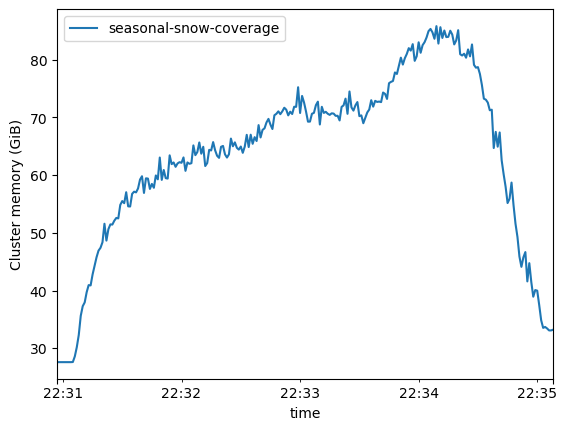

In [24]:
ms.plot()

Looking at the plot above shows that we utilised just over 80GB of distributed memory during our processing.
These plots are useful to determine repeatable workflows and provisioning cost-effective resourcing.

In [ ]:
ms.to_pandas().to_csv('seasonal-snow-cover-plot-data.csv')

Dask is capable of generating performance reports, rendered to HTML, and embeddable in reports.

In [26]:
HTML(filename='seasonal-snow-coverage.html')

### Water Basin Analysis

A more informative use-case for the seasonal snow-cover composites created above is to focus on specific water-basins in order to determine particular threat levels against avalanche (can be cross referenced against elevation data), potential large run-off events which could lead to downstream flooding in sensitive areas, and 

In [9]:
# Retrieve the 
shp_file = glob('/home/jovyan/geoanalytics_user_shared_data/AOIs/nhn-index/*.shp')[0]
gdf = gpd.read_file(shp_file)
df = gdf[gdf.intersects(aoi)]
df.head()

,PROVCD_1,PROVCD_2,PROVCD_3,PROVCD_4,VALDATE,EDITION,DATASETNAM,VERSION,COMPLEVEL,WSCMDA,WSCSDA,WSCSSDA,FDA,OCEAN,WSCMDANAME,WSCSDANAME,WSCSSDANAM,geometry
0,NaN,NaN,NaN,NaN,NaN,NaN,01AA000,NaN,NHN-CL2,01,01A,01AA,01AA,Atlantic Ocean,Maritime Provinces Drainage Area,Saint John and Southern Bay of Fundy (N.B.),Headwaters Saint John,"POLYGON ((-70.28653 46.12011, -70.28627 46.120..."
1,NaN,NaN,NaN,NaN,NaN,NaN,01AB000,NaN,NHN-CL2,01,01A,01AB,01AB,Atlantic Ocean,Maritime Provinces Drainage Area,Saint John and Southern Bay of Fundy (N.B.),Upper Saint John - Big Black,"POLYGON ((-69.67397 47.24681, -69.67251 47.247..."
2,NaN,NaN,NaN,NaN,NaN,NaN,01AD000,NaN,NHN-CL2,01,01A,01AD,01AD,Atlantic Ocean,Maritime Provinces Drainage Area,Saint John and Southern Bay of Fundy (N.B.),Upper Saint John - St. Francis,"POLYGON ((-69.36749 47.58726, -69.36506 47.589..."
3,NaN,NaN,NaN,NaN,NaN,NaN,01AF000,NaN,NHN-CL2,01,01A,01AF,01AF,Atlantic Ocean,Maritime Provinces Drainage Area,Saint John and Southern Bay of Fundy (N.B.),Upper Saint John - Verte,"POLYGON ((-67.46647 47.38328, -67.46495 47.383..."
17,NaN,NaN,NaN,NaN,NaN,NaN,01BB000,NaN,NHN-CL2,01,01B,01BB,01BB,Atlantic Ocean,Maritime Provinces Drainage Area,Gulf of St. Lawrence and Northern Bay of Fundy...,Kedgwick,"POLYGON ((-68.14438 48.16030, -68.14443 48.161..."


In [ ]:
# List out all the water basins that intersect with our AOI
df['WSCSSDANAM'].dropna(how='any').values.tolist()

In [11]:
# Select a target water basin we want to focus on
target_basin = 'Lower Arnaud'

In [ ]:
# Grab water basin geometry and visualise on an interactive map
basin_df = df[df['WSCSSDANAM'] == target_basin].geometry
basin_df.explore()

In [23]:
# Merge geometry polygons together to simplify clipping in the next step
basin_mp = MultiPolygon([poly for poly in basin_df.geometry.values.tolist() if isinstance(poly, Polygon)])
basin_mp;

We now can clip our AOI time series to our target water basin AOI using the created MultiPolygon in the previous step. 

In [ ]:
basin_arrs = []
for key in seasonal_medians.keys():
    season_arr = seasonal_medians[key]
    season_arr.rio.write_crs(3978, inplace=True)
    basin_arrs.append(season_arr.rio.clip([basin_mp], crs=4326, all_touched=True))
basin_arrs;

In [25]:
# We can pull the data down from the Dask Cluster to the local notebook
# in order to minimise needing to reprocess data
basin_arrs_c = dask.compute(basin_arrs)[0]

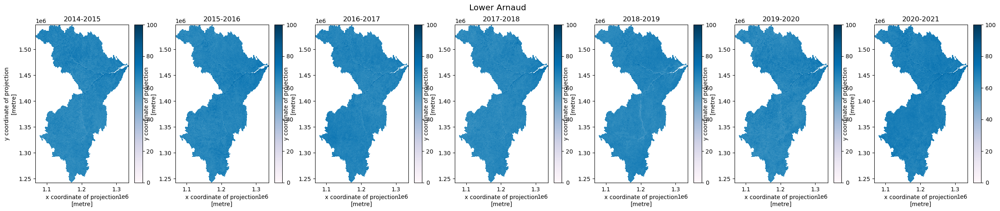

In [26]:
season_keys = list(seasonal_medians.keys())
fig, ax = plt.subplots(1, len(basin_arrs_c), figsize=(30,5))
fig.suptitle(target_basin, fontsize='x-large')
for i in range(len(basin_arrs_c)):
    basin_arrs_c[i].plot.imshow(ax=ax[i], vmin=0, vmax=100, cmap='PuBu')
    ax[i].set_title(season_keys[i])
plt.show()

In [ ]:
fig.savefig(target_basin+'.png')

We have our seven winter seasons plotted sequentially isolating the water-basins contributing to the Lower Arnaud in Quebec. 
What you can do with these, either as the seasonal or if seasonal composites were skipped then mapping to the monthly composites, is provide a wealth of information through further analyses either pixelwise or further isolating regions of interest within the target AOI (Quebec to water-basin or land features within water-basins for name two of many examples).
The implications of providing quick and accurate scientific data is essential to reaching goals sooner. 

## Appendix

One single image that was corrupted was interfering with the integrity of the subsequent data generation, so, due to the ability to perform quick inspection and re-processing, it was possible to identify which array was culprit and remove it.
In this particular demonstration, it was simply removed, however, it would be easy enough to take a step further back and identify the individual days from this seasonal window and remove those. 

'2018-2019' at index 5 - Feburary 2019. 